Benchmark of DLPFC dataset
-- only MNN

In [1]:
import os,sys
sys.path.append(os.path.realpath(os.path.join(os.getcwd(), '..')))
import warnings
import scanpy as sc
import anndata as ad
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import mucostx as mx

In [2]:
opt = mx.config()
args = opt.parse_args(['--gpu', '0'])
args.dataset_path = '/mnt/d/Dataset/SRT_Dataset/1-DLPFC/'
args.cluster = 7
args.elastic_corr = True
if args.version.split('-')[0] != 'dev':
    warnings.filterwarnings("ignore")
args

Namespace(amp=True, batch_size=512, cluster=7, clusters=0, dataset_path='/mnt/d/Dataset/SRT_Dataset/1-DLPFC/', dropout=0.3, elastic_corr=True, flow='source_to_target', gpu=0, hvgs=3000, latent_dim=64, log_file='../Log', log_steps=20, lr=0.001, max_epoch=100, max_neighbors=6, mode_rknn='rknn', n_spot=0, out_file='../Output', project_name='MoCoSTX', seed=2024, srt_resolution=150, tau=0.05, version='dev-1.0', visual=True, wegiht_decay=0.0001)

In [3]:
mx.set_random_seed(args.seed)

In [4]:
# sections = ['151673', '151674', '151675', '151676']
sections = ['151507', '151508', '151509', '151510','151669', '151670', '151671', '151672', '151673', '151674', '151675', '151676']

In [5]:
adata_list = []
for section in sections:
    adata = sc.read_visium(os.path.join(args.dataset_path+section))
    adata.var_names_make_unique()
    sc.pp.filter_genes(adata, min_cells=10)
    # sc.pp.filter_cells(adata, min_genes=200)
    # sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=10000)
    # adata = adata[:, adata.var['highly_variable']]
    Ann_df = pd.read_csv(os.path.join(args.dataset_path+'1-DLPFC_annotations/', section+'_truth.txt'), sep='\t', header=None, index_col=0)
    Ann_df.columns = ['Ground Truth']
    adata.obs['Ground Truth'] = Ann_df.loc[adata.obs_names, 'Ground Truth']
    adata_list.append(adata)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are n

Before alignment

In [6]:
adata_raw = ad.concat(adata_list, keys=sections,label="slice_name", join='inner')
sc.pp.highly_variable_genes(adata_raw, flavor="seurat_v3", n_top_genes=3000)
global_hvg = adata_raw.var_names[adata_raw.var['highly_variable']]
sc.pp.filter_cells(adata_raw, min_genes=200)
sc.pp.normalize_total(adata_raw, target_sum=1e4)
sc.pp.log1p(adata_raw)
adata_raw = adata_raw[:, global_hvg]
sc.pp.scale(adata_raw, zero_center=True, max_value=10)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [7]:
adata_raw.obsm['spatial']

array([[3276, 2514],
       [9178, 8520],
       [5133, 2878],
       ...,
       [4684, 9827],
       [4491, 8029],
       [6177, 3489]])

In [8]:
adata_raw

AnnData object with n_obs × n_vars = 47632 × 3000
    obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'slice_name', 'n_genes'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p'
    obsm: 'spatial'

In [9]:
def mclust(adata, arg, refine=False):
    from sklearn.decomposition import PCA
    pca = PCA(n_components=32, random_state=arg.seed)
    embedding = pca.fit_transform(adata.X.copy())
    adata.obsm['emb_pca'] = embedding
    import rpy2.robjects as r_objects
    r_objects.r.library("mclust")
    import rpy2.robjects.numpy2ri
    rpy2.robjects.numpy2ri.activate()
    r_random_seed = r_objects.r['set.seed']
    r_random_seed(arg.seed)
    rmclust = r_objects.r['Mclust']
    res = rmclust(rpy2.robjects.numpy2ri.numpy2rpy(adata.obsm['emb_pca']), arg.n_domain, 'EEE')

    mclust_res = np.array(res[-2])
    adata.obs['mclust'] = mclust_res
    adata.obs['mclust'] = adata.obs['mclust'].astype('int')
    adata.obs['mclust'] = adata.obs['mclust'].astype('category')

    return adata

In [10]:
mucostx = mx.MuCoSTX1(adata_list, args)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocess

section 4218 and 4378 has 15949 mnn edges
section 4218 and 4784 has 15713 mnn edges
section 4218 and 4626 has 15937 mnn edges
section 4218 and 3659 has 12770 mnn edges
section 4218 and 3494 has 12654 mnn edges
section 4218 and 4106 has 13327 mnn edges
section 4218 and 4012 has 13149 mnn edges
section 4218 and 3636 has 11907 mnn edges
section 4218 and 3673 has 12551 mnn edges
section 4218 and 3589 has 12813 mnn edges
section 4218 and 3457 has 12460 mnn edges
section 4378 and 4784 has 15914 mnn edges
section 4378 and 4626 has 15850 mnn edges
section 4378 and 3659 has 12430 mnn edges
section 4378 and 3494 has 12049 mnn edges
section 4378 and 4106 has 13069 mnn edges
section 4378 and 4012 has 12716 mnn edges
section 4378 and 3636 has 10793 mnn edges
section 4378 and 3673 has 11655 mnn edges
section 4378 and 3589 has 12017 mnn edges
section 4378 and 3457 has 11400 mnn edges
section 4784 and 4626 has 18205 mnn edges
section 4784 and 3659 has 12056 mnn edges
section 4784 and 3494 has 11895 mn

  0%|          | 0/100 [00:00<?, ?it/s]

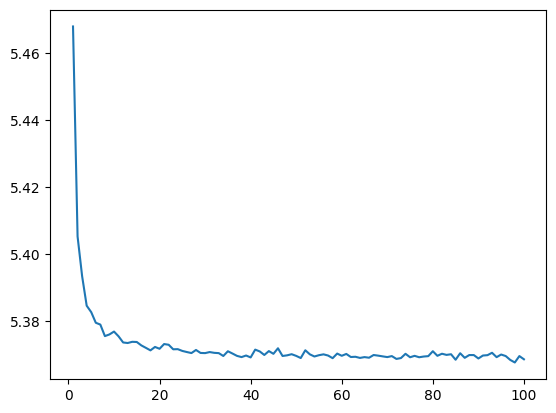

In [11]:
mucostx.train_emb()

Downstream workflow

In [12]:
list_new = mucostx.get_adata_all()
list_new

[AnnData object with n_obs × n_vars = 4218 × 3000
     obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mean', 'std'
     uns: 'spatial', 'log1p'
     obsm: 'spatial', 'X_pca', 'mxb',
 AnnData object with n_obs × n_vars = 4378 × 3000
     obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mean', 'std'
     uns: 'spatial', 'log1p'
     obsm: 'spatial', 'X_pca', 'mxb',
 AnnData object with n_obs × n_vars = 4784 × 3000
     obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mean', 'std'
     uns: 'spatial', 'log1p'
     obsm: 'spatial', 'X_pca', 'mxb',
 AnnData object with n_obs × n_vars = 4626 × 3000
     obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mean', 'std'
   

In [13]:
# list_new[6].obs['isodepth']

In [14]:
# import matplotlib.pyplot as plt

# # 获取 isodepth 值
# isodepth = list_new[0].obs['isodepth']

# # 绘制直方图
# plt.figure(figsize=(8, 6))
# plt.hist(isodepth, bins=30, color='skyblue', edgecolor='black')
# plt.title('Distribution of IsoDepth', fontsize=16)
# plt.xlabel('IsoDepth Value', fontsize=14)
# plt.ylabel('Frequency', fontsize=14)
# plt.grid(True)
# plt.show()


In [15]:
# sc.pl.spatial(list_new[0],color=['isodepth'])

In [16]:
# sc.pl.spatial(list_new[9],color=['isodepth'],img_key=None)

绘制等高线

In [17]:
adata_new1 = ad.concat(list_new, keys=sections,label="slice_name")

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [18]:
adata_new1

AnnData object with n_obs × n_vars = 47632 × 3000
    obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes', 'slice_name'
    obsm: 'spatial', 'X_pca', 'mxb'

In [19]:
from mucostx.utils import mclust
args.n_domain=7
adata_new1 = mclust(adata_new1, args, refine=False, use='mxb')
from sklearn.metrics import adjusted_rand_score
adata_new1 = adata_new1[~pd.isnull(adata_new1.obs['Ground Truth'])]
obs_df = adata_new1.obs.dropna()
ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
print(f'overall ARI: {ARI}')

   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 6.1.1
Type 'citation("mclust")' for citing this R package in publications.



fitting ...
  |======================================================================| 100%
overall ARI: 0.45273607184287906


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping pr

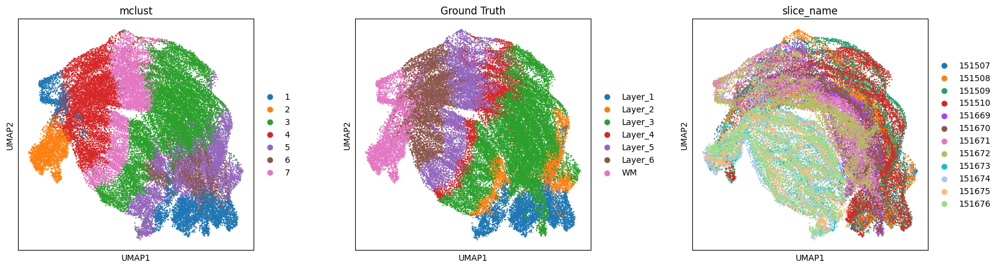

In [20]:
sc.pp.neighbors(adata_new1, use_rep='mxb')
sc.tl.umap(adata_new1)
plt.rcParams["figure.figsize"] = (5, 5)
sc.pl.umap(adata_new1, color=["mclust", "Ground Truth", 'slice_name'], size=10, ncols=3,wspace=0.3, show=True)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


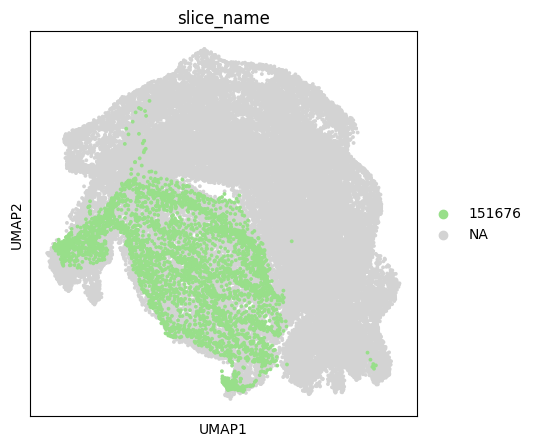

In [21]:
sc.pl.umap(adata_new1, color='slice_name', groups=[sections[11]],size=30)

batch corrected

In [22]:
sc.pl.spatial(adata_filtered, basis='spatial',color='Ground Truth', spot_size=150, frameon=False)

NameError: name 'adata_filtered' is not defined

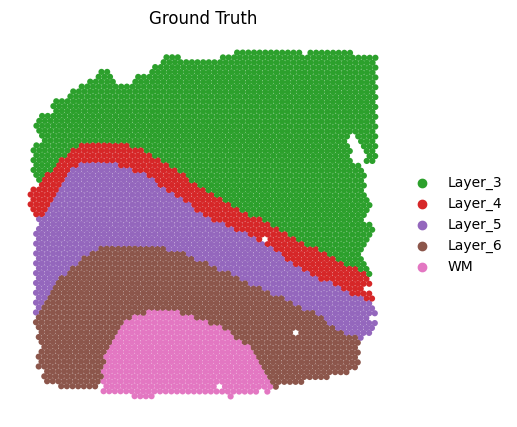

In [ ]:
sc.pl.spatial(adata_1, basis='spatial',color='Ground Truth', spot_size=150, frameon=False)

In [ ]:
-

SyntaxError: invalid syntax (476313318.py, line 1)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


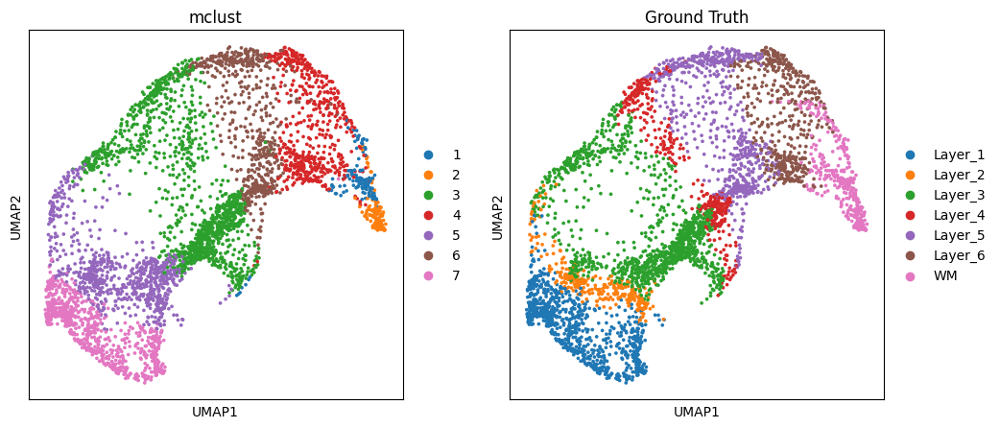

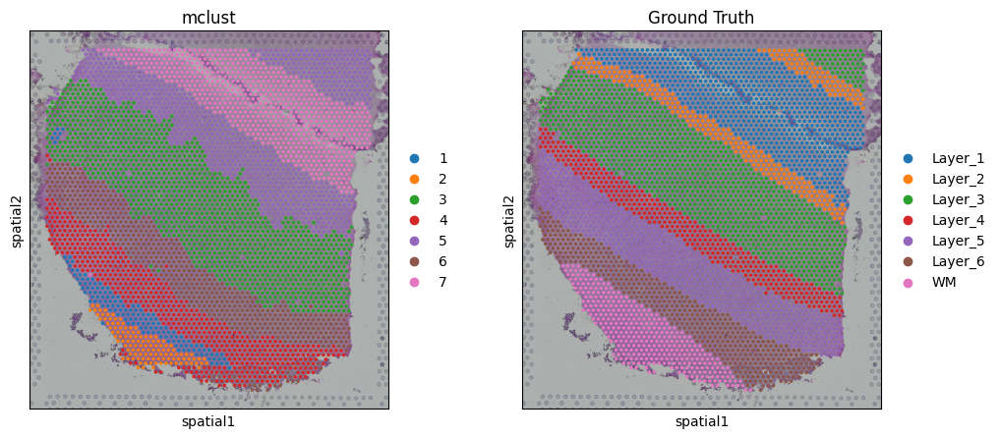

section 151507, ARI: 0.5255562074850155


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


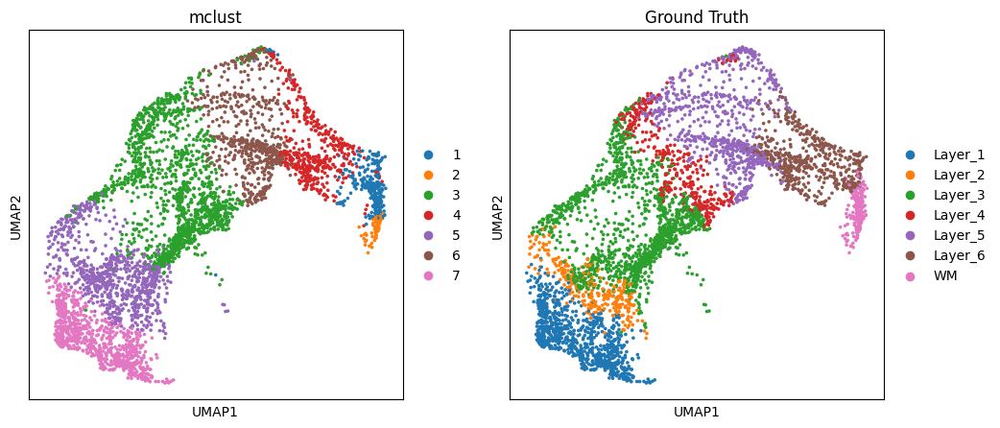

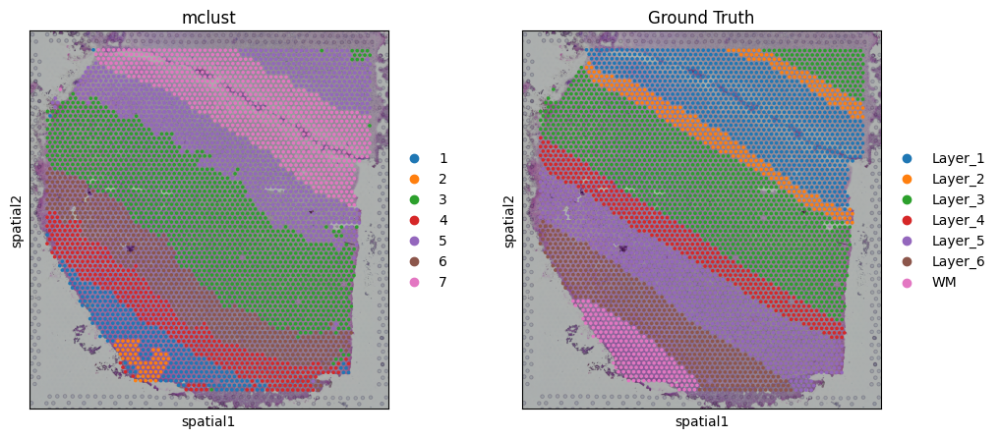

section 151508, ARI: 0.528095646448879


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


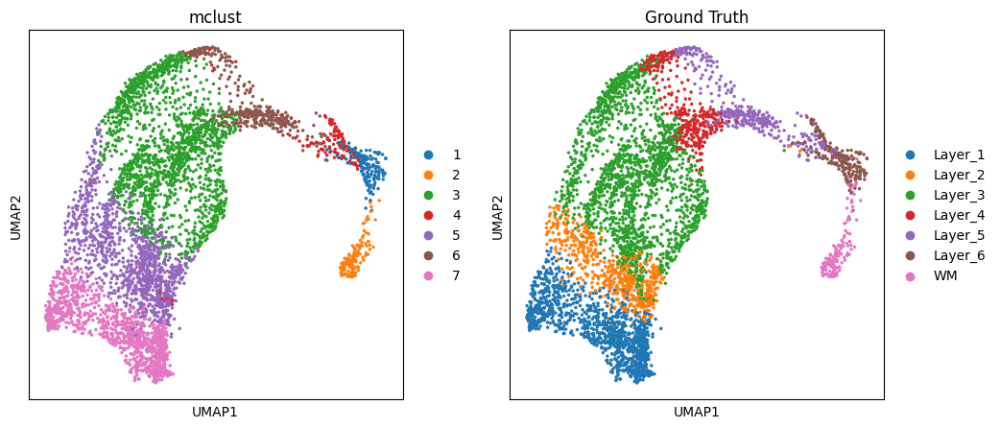

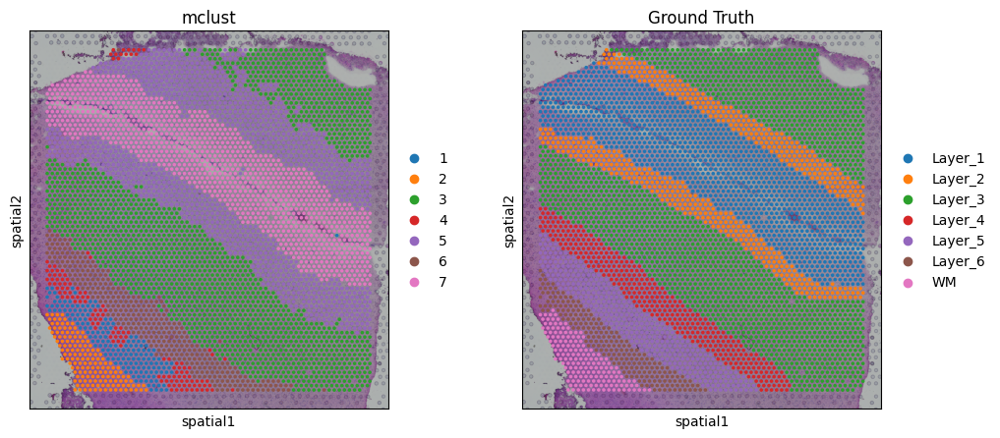

section 151509, ARI: 0.5955509807625391


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


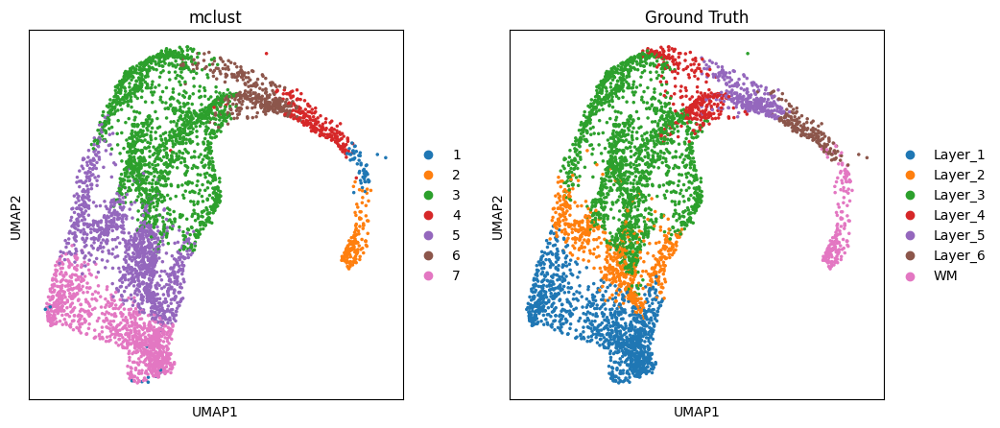

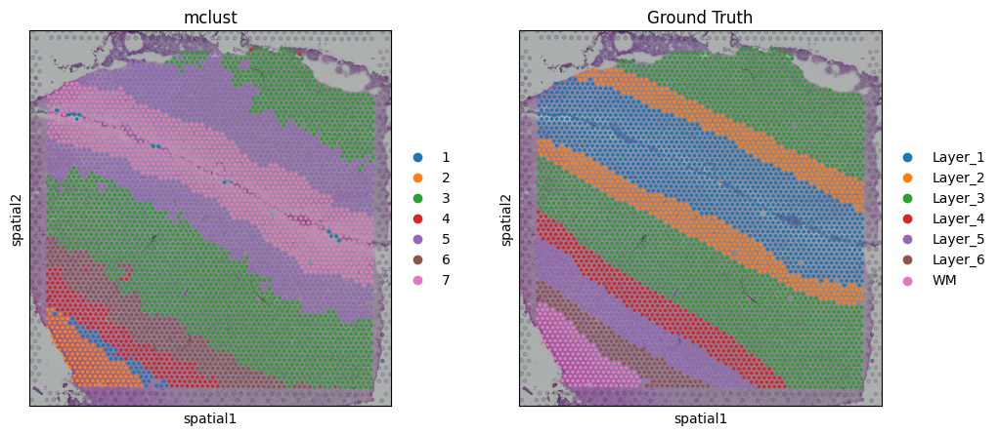

section 151510, ARI: 0.5907650208034024


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


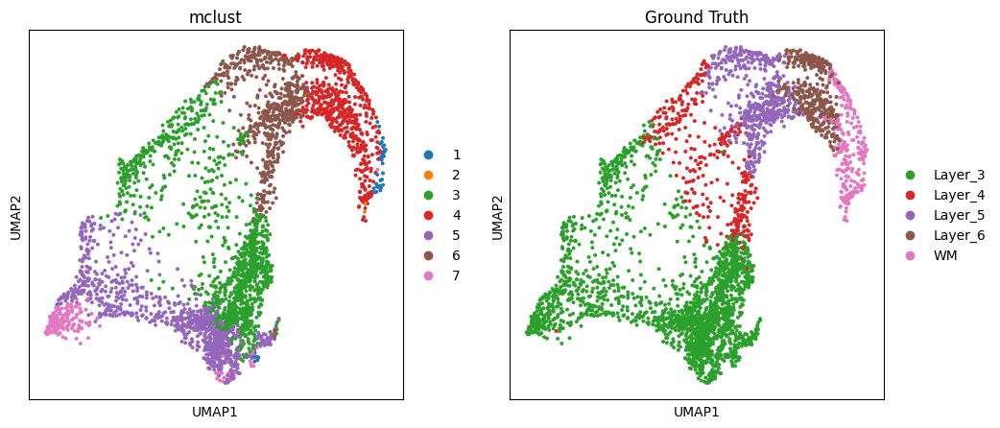

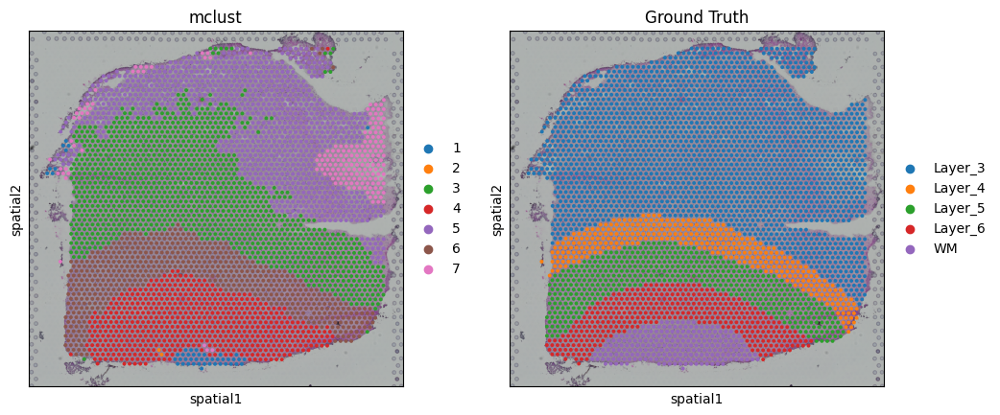

section 151669, ARI: 0.3824290915631387


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


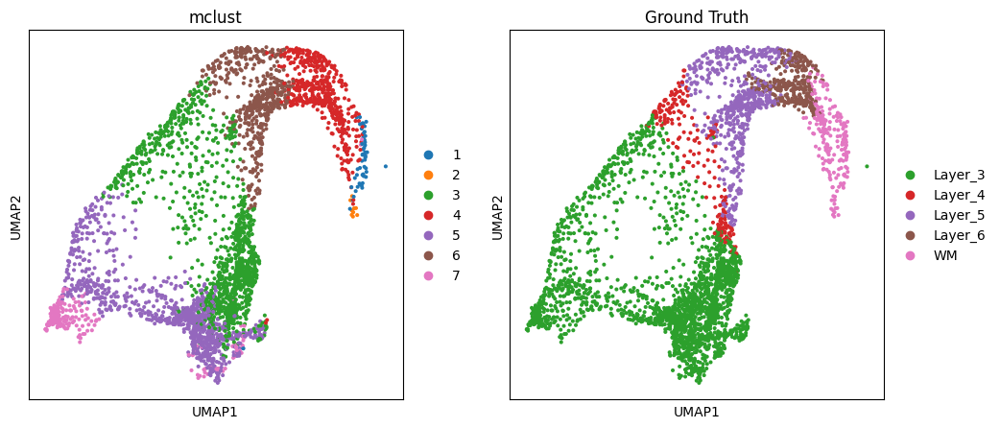

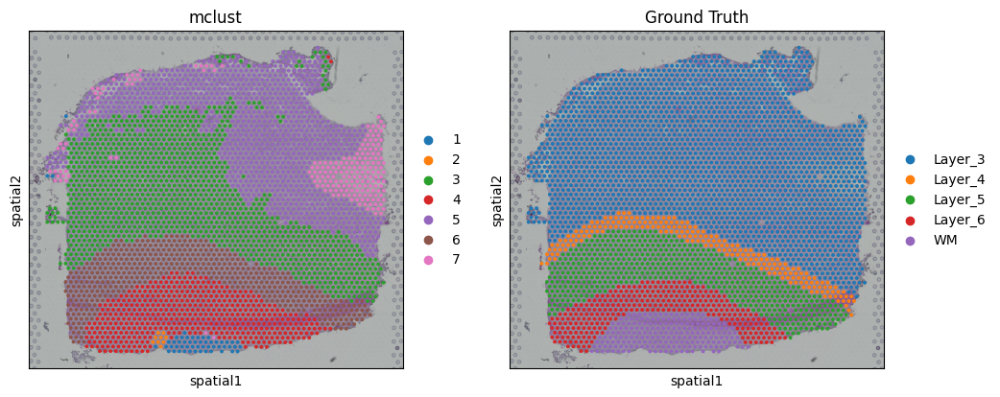

section 151670, ARI: 0.3598542542165163


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


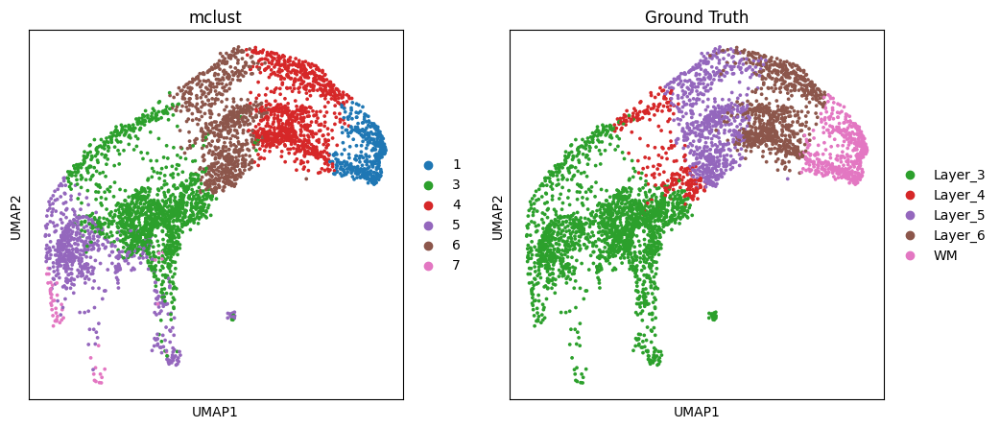

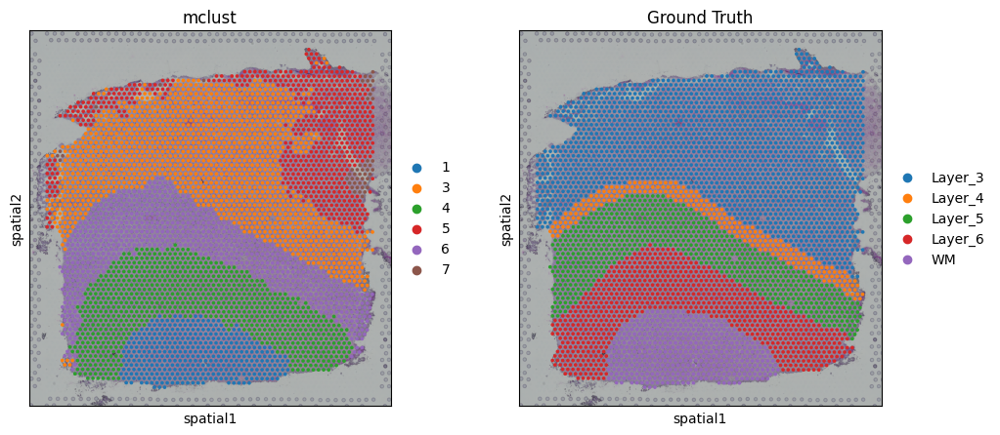

section 151671, ARI: 0.5789262687116571


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


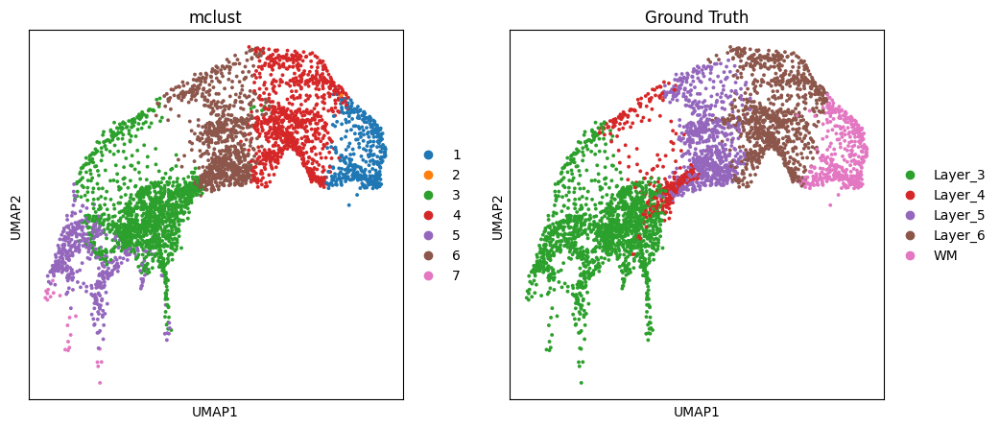

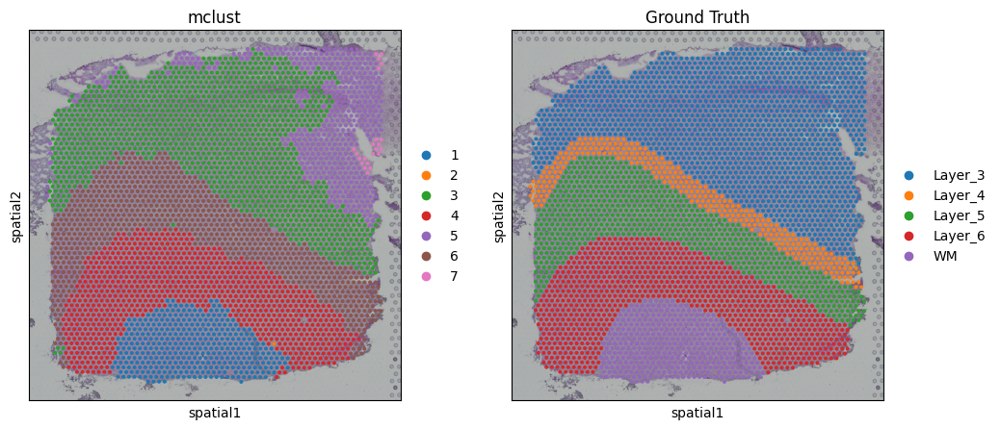

section 151672, ARI: 0.6090497321010255


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


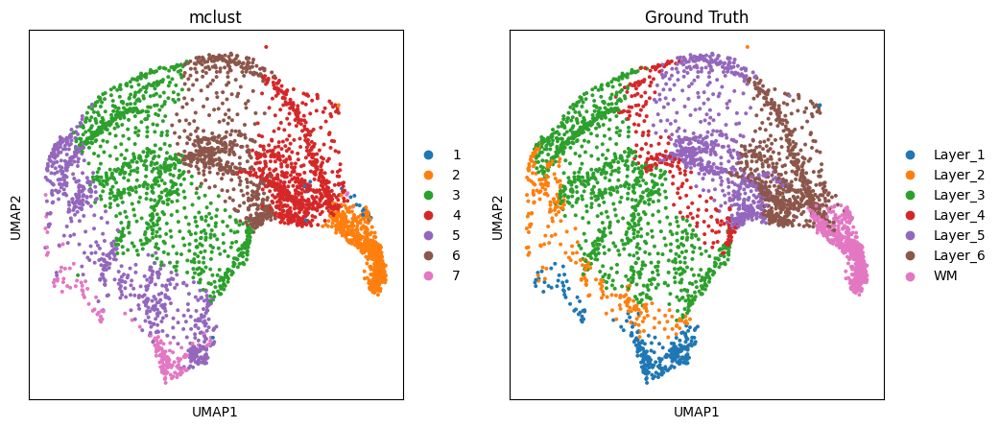

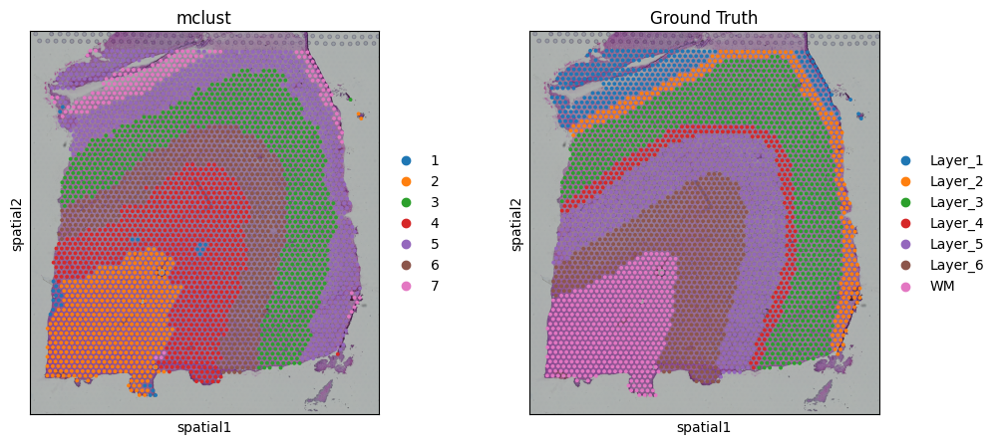

section 151673, ARI: 0.6260848511760257


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


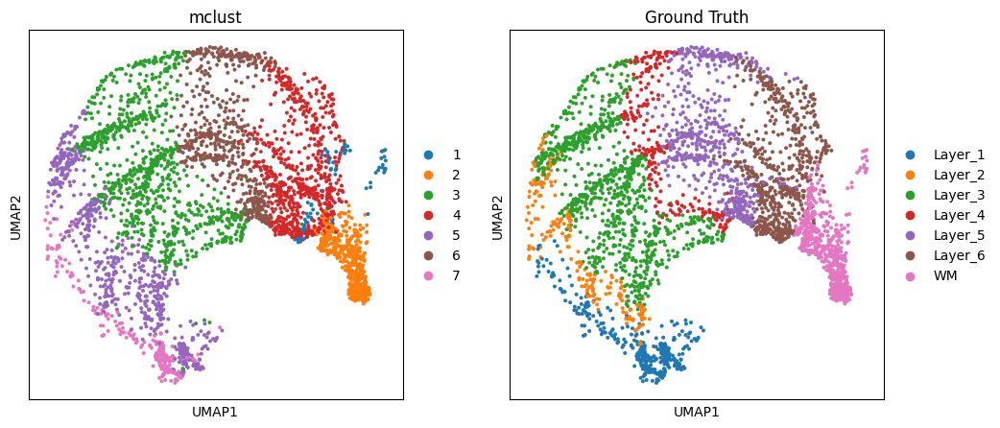

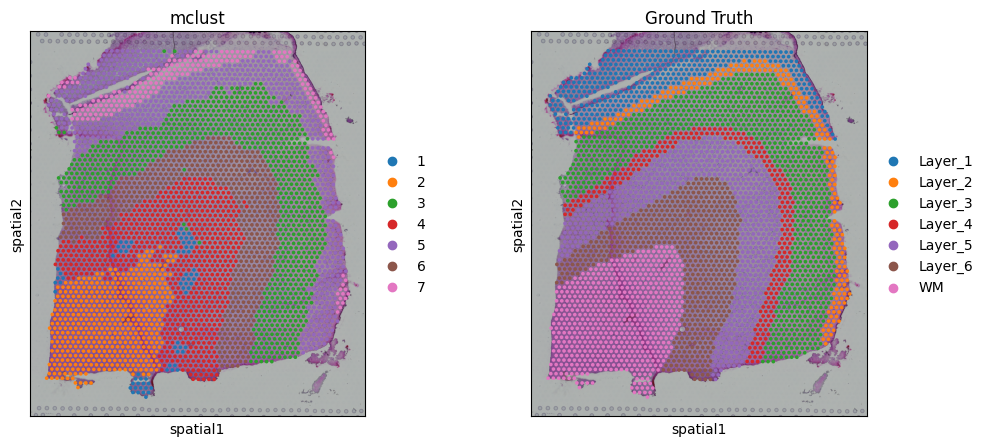

section 151674, ARI: 0.5948445318299156


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


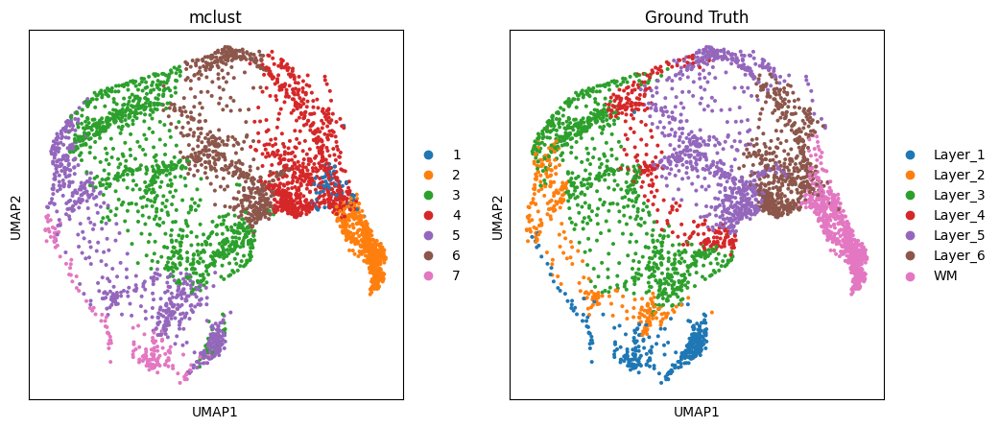

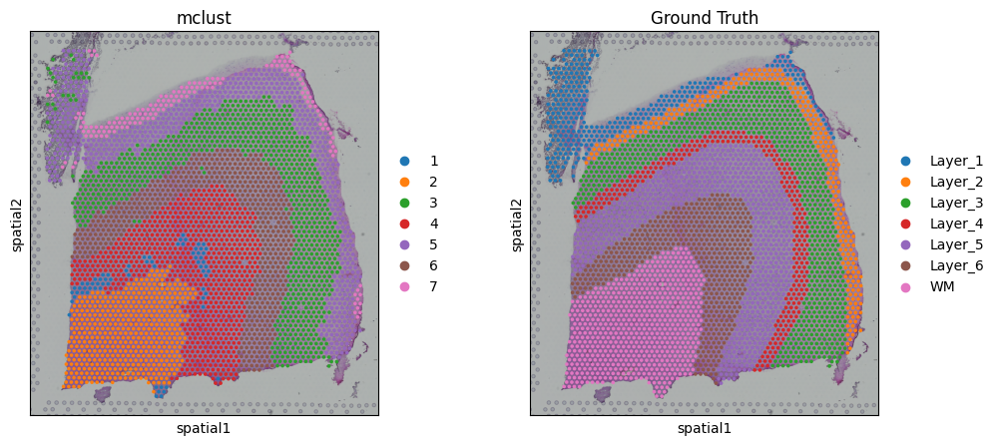

section 151675, ARI: 0.5299153779421526


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


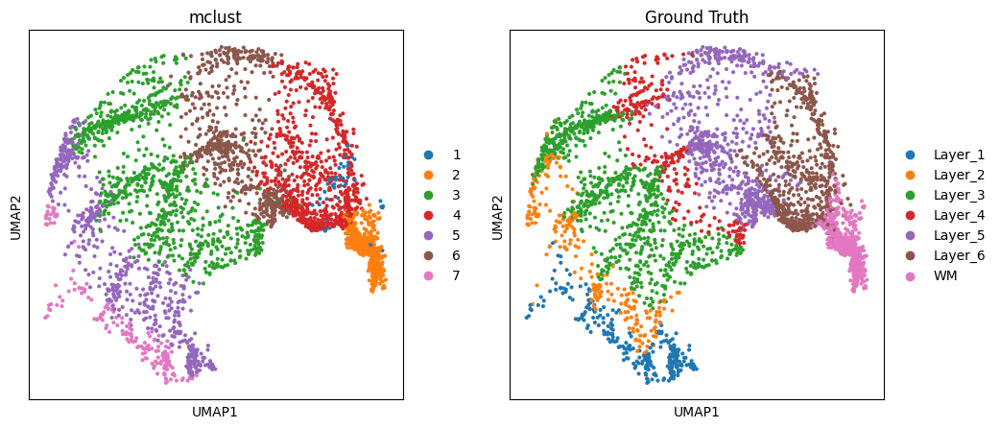

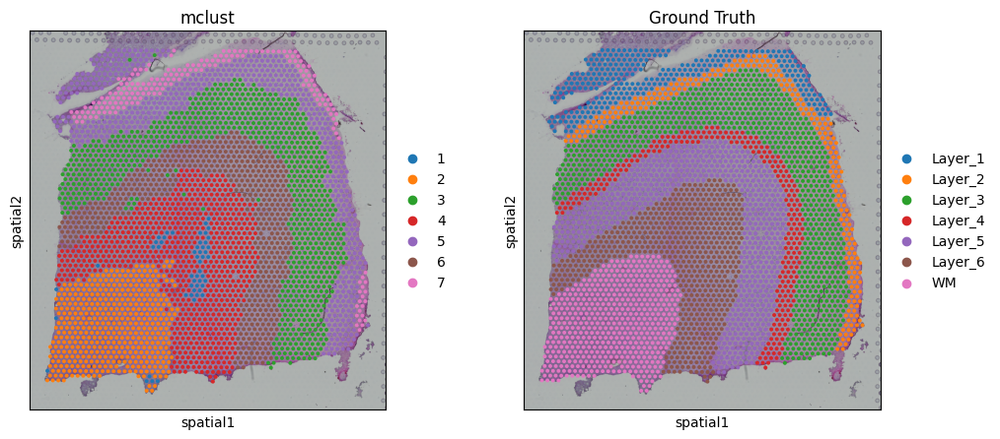

section 151676, ARI: 0.5873436892669637


In [ ]:
for i, sli in enumerate(sections):
    adata_151 = adata_new[adata_new.obs['slice_name']==sli,:]
    adata_151
    sc.pl.umap(adata_151, color=["mclust", "Ground Truth"])
    adata_151.uns = adata_list[i].uns
    sc.pl.spatial(adata_151,color=["mclust", "Ground Truth"])
    from sklearn.metrics import adjusted_rand_score
    adata_151 = adata_151[~pd.isnull(adata_151.obs['Ground Truth'])]
    obs_df = adata_151.obs.dropna()
    ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
    print(f'section {sli}, ARI: {ARI}')

In [ ]:
# save_dir = args.dataset_path+'adata_all/'
# os.makedirs(save_dir, exist_ok=True)

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


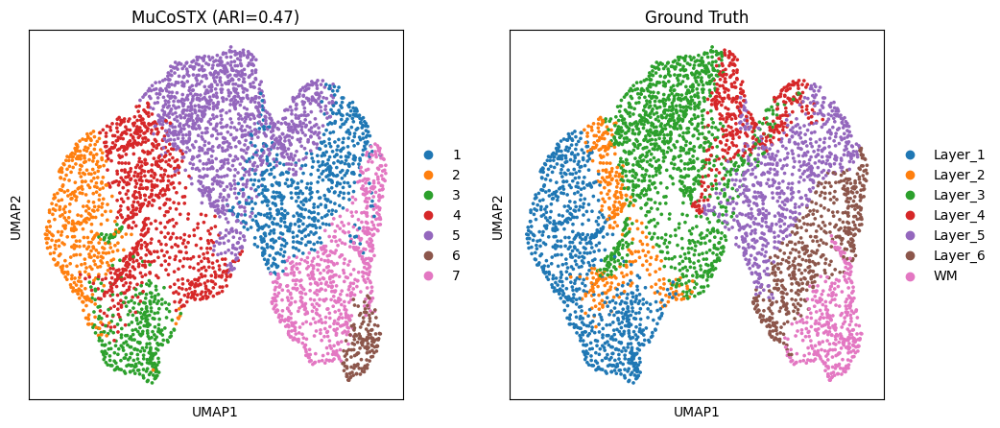

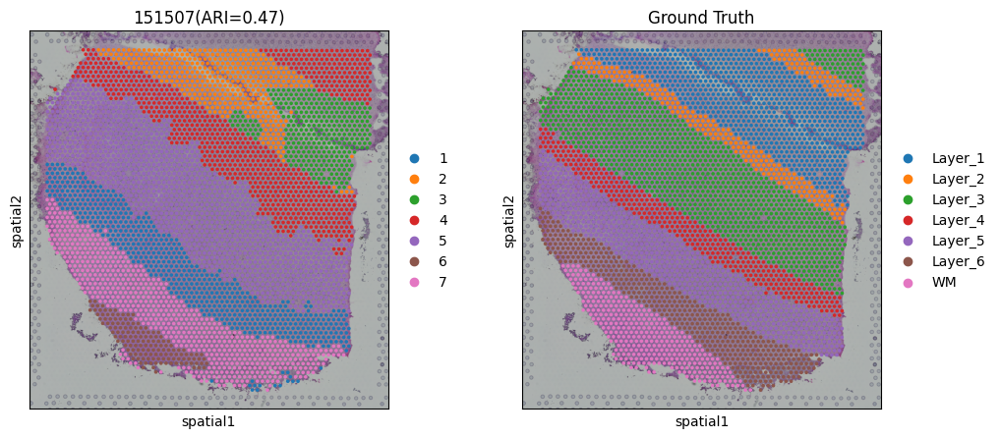

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


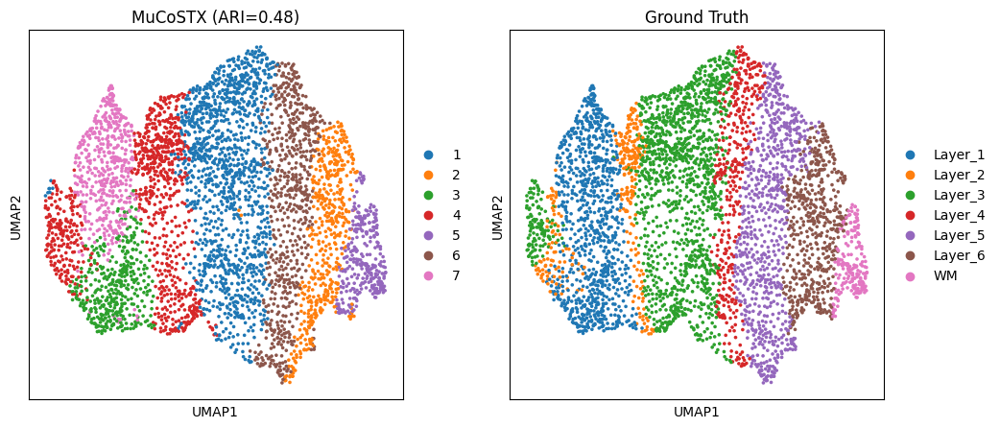

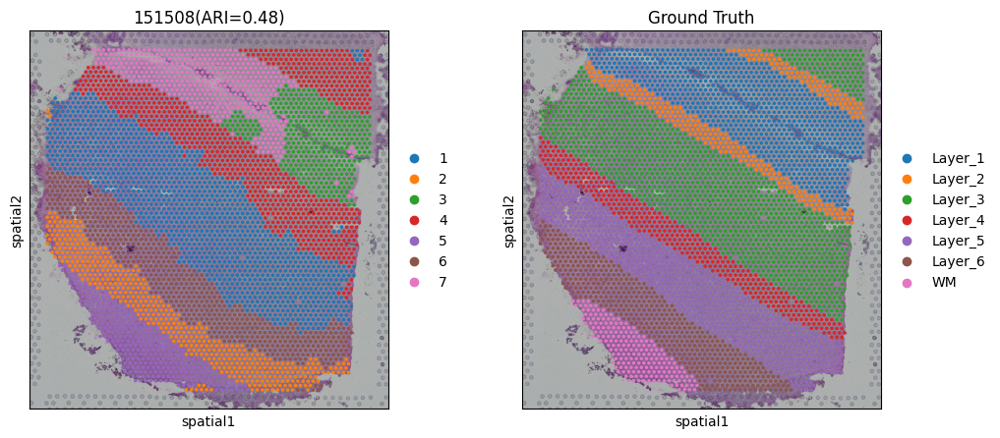

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


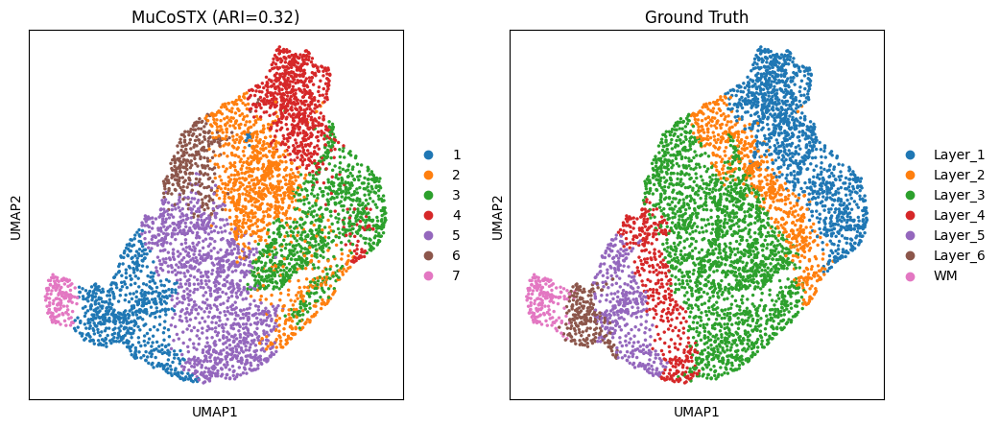

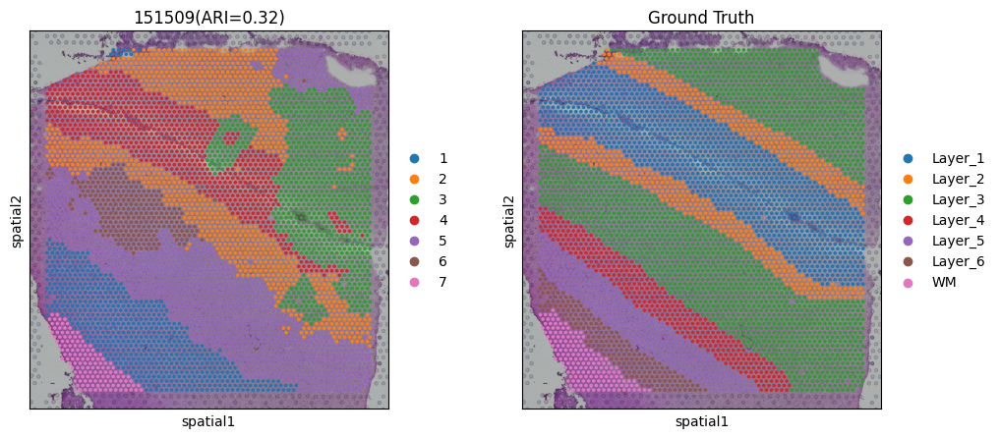

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


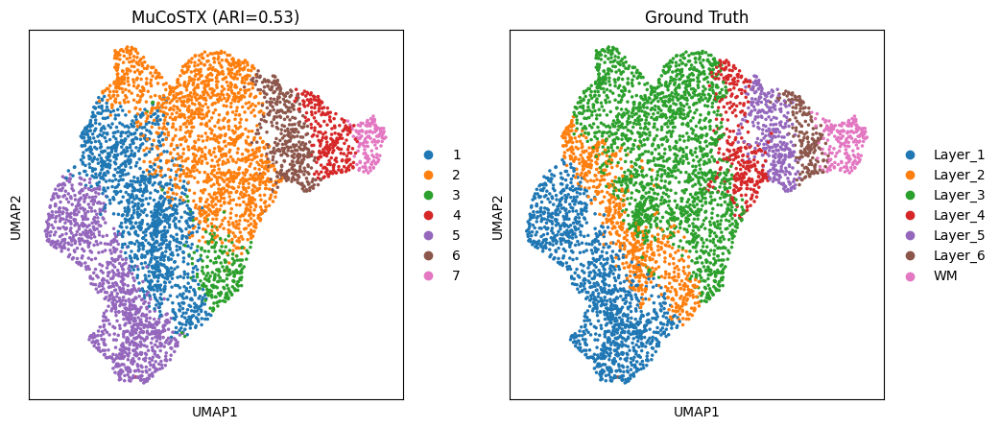

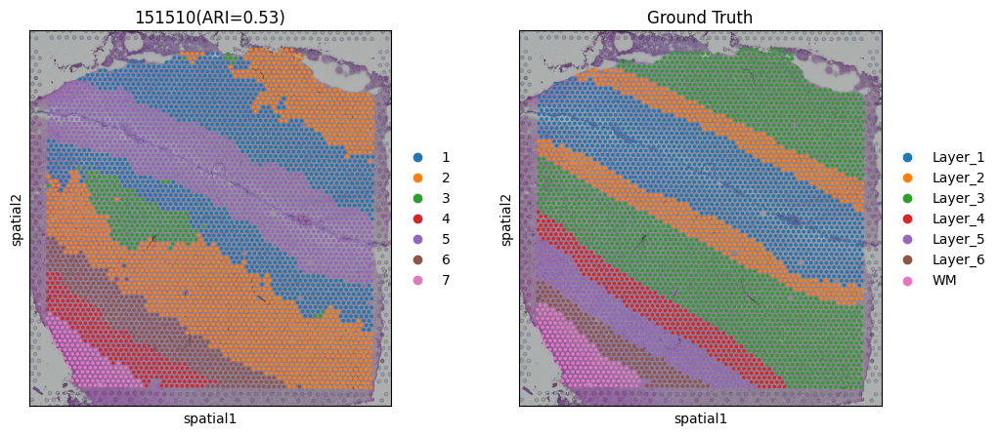

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


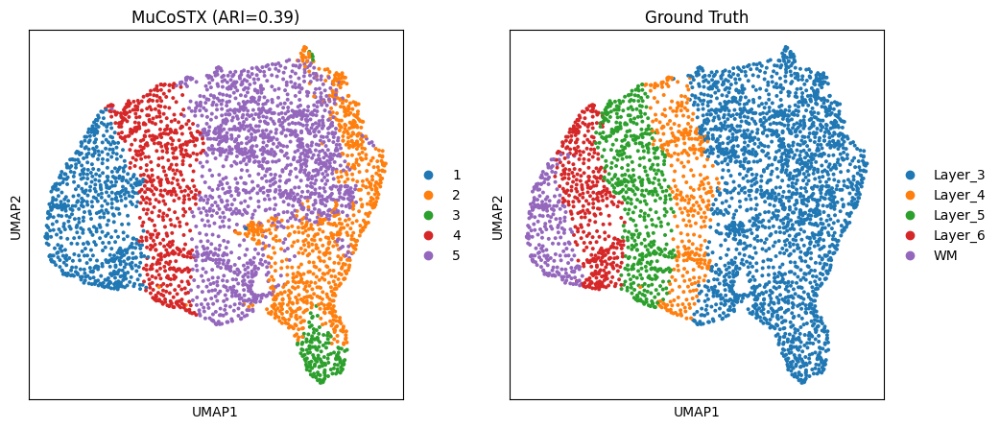

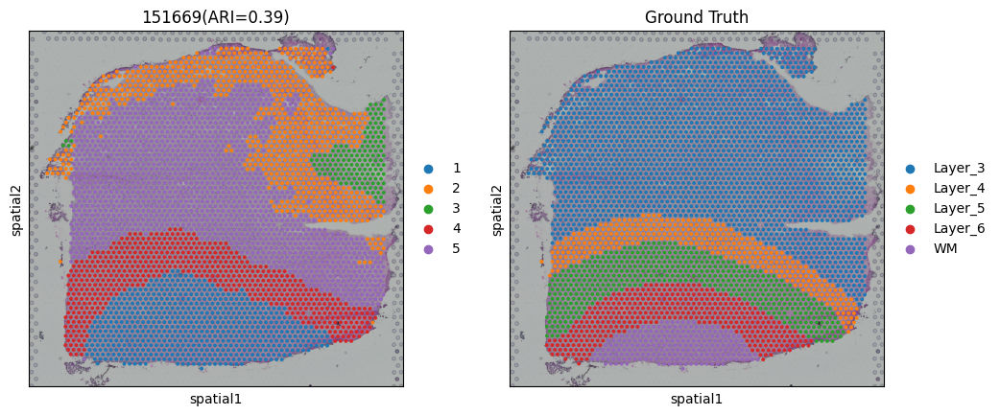

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


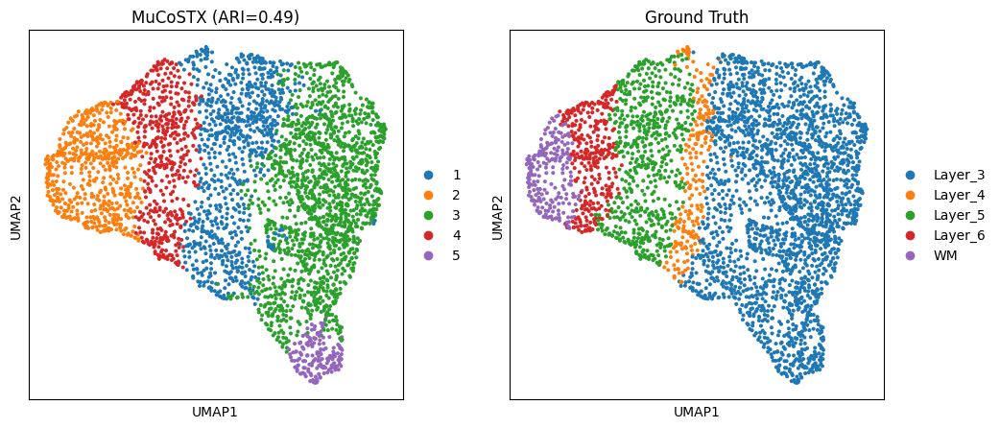

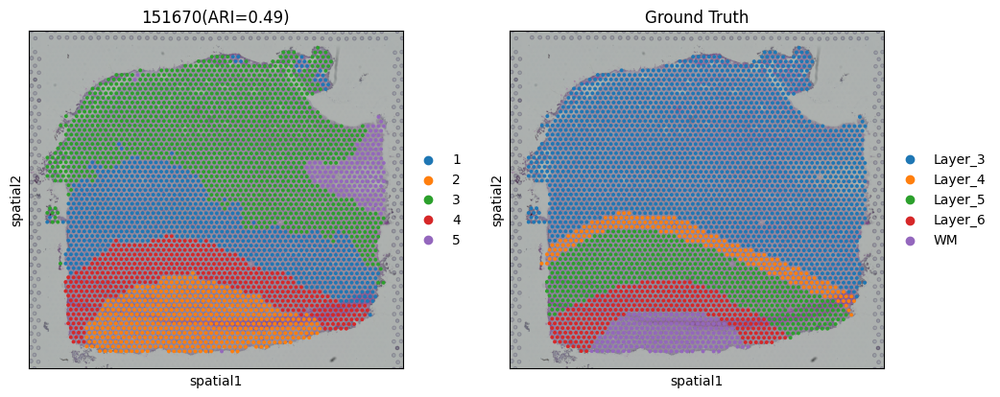

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


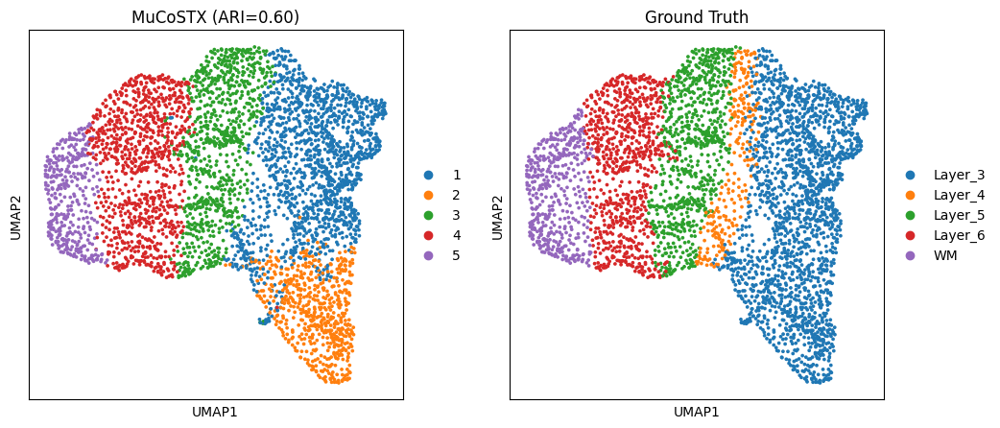

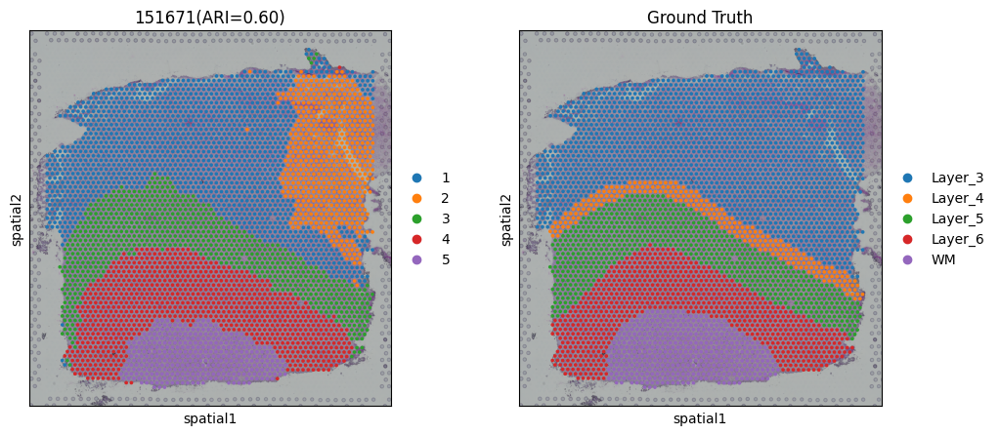

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


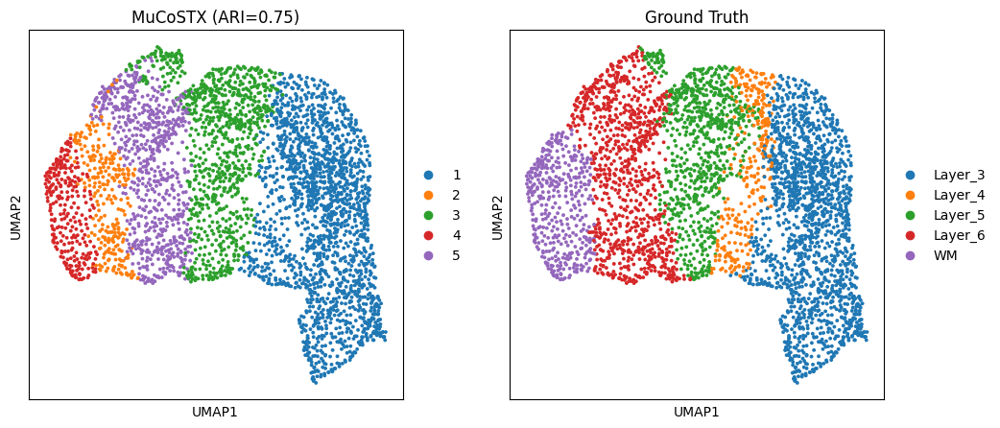

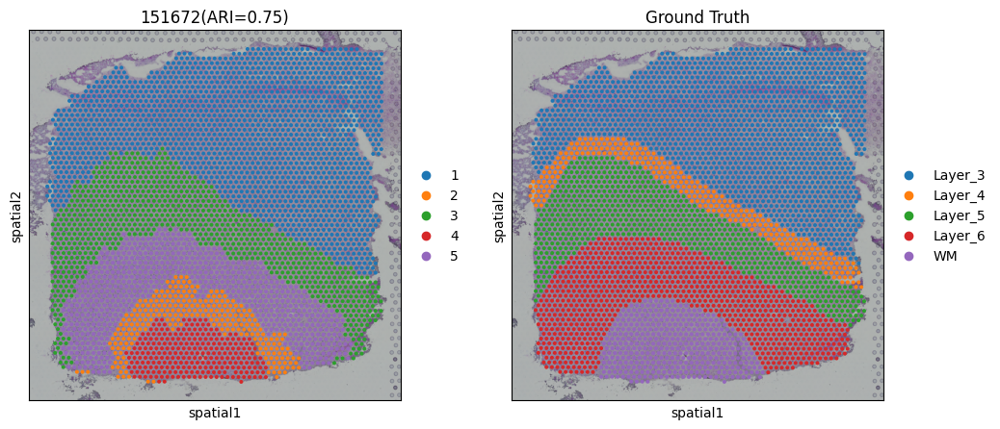

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


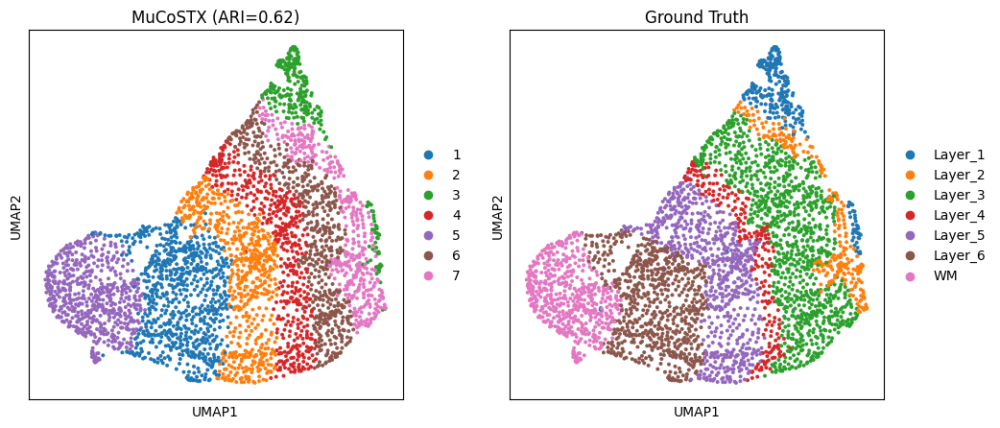

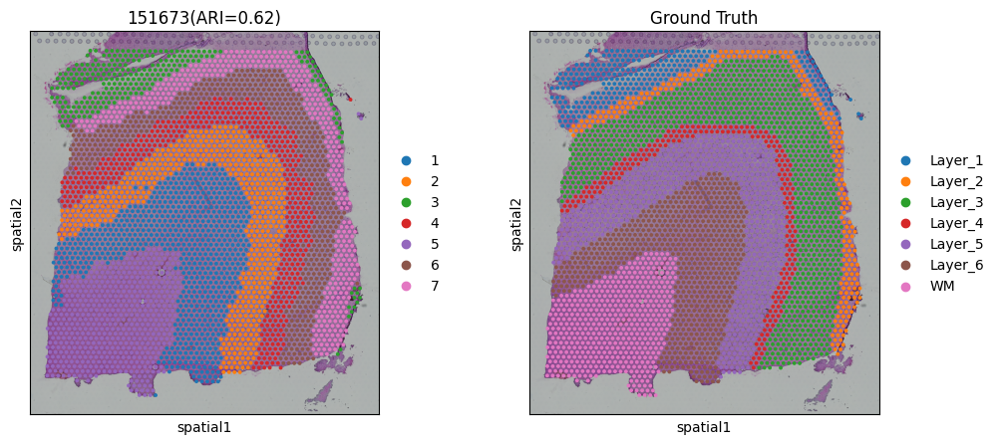

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


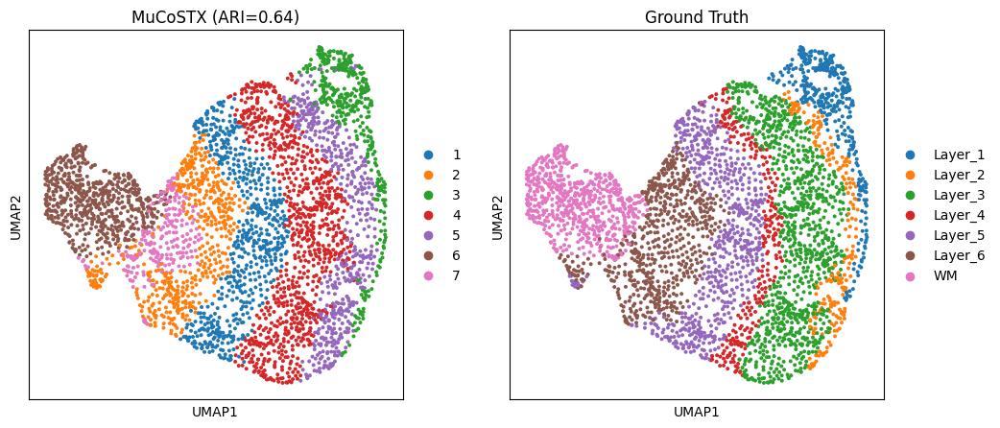

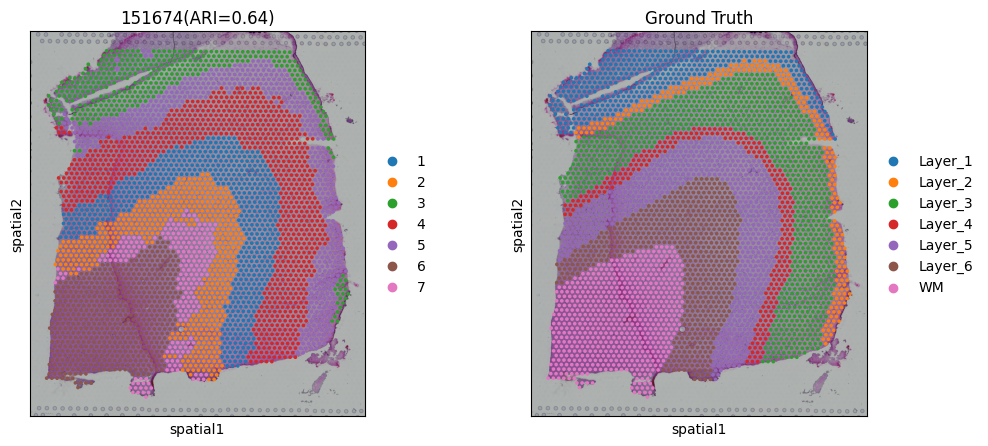

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


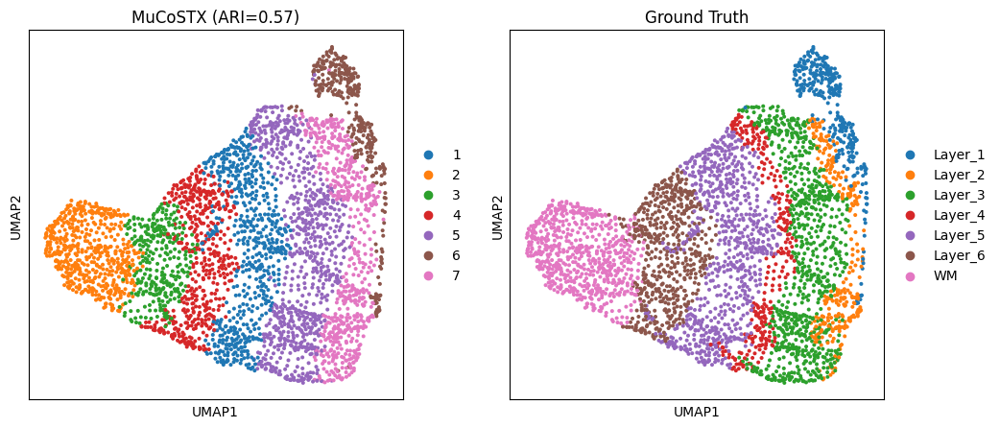

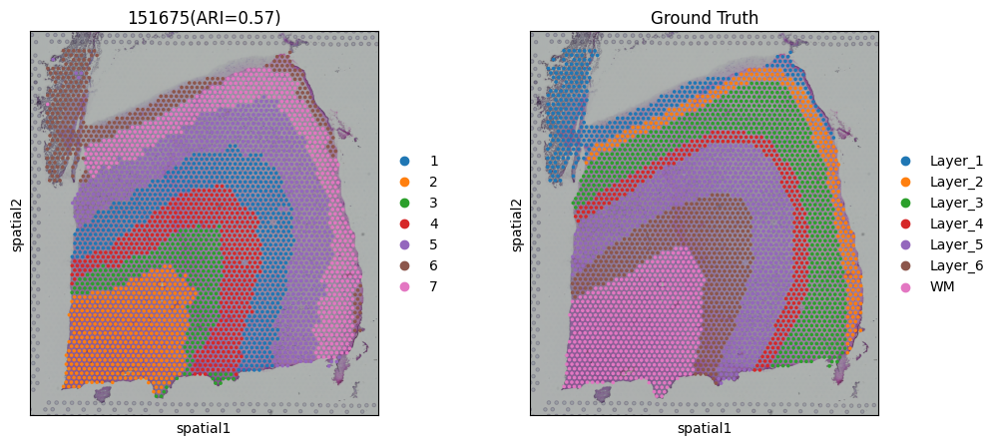

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


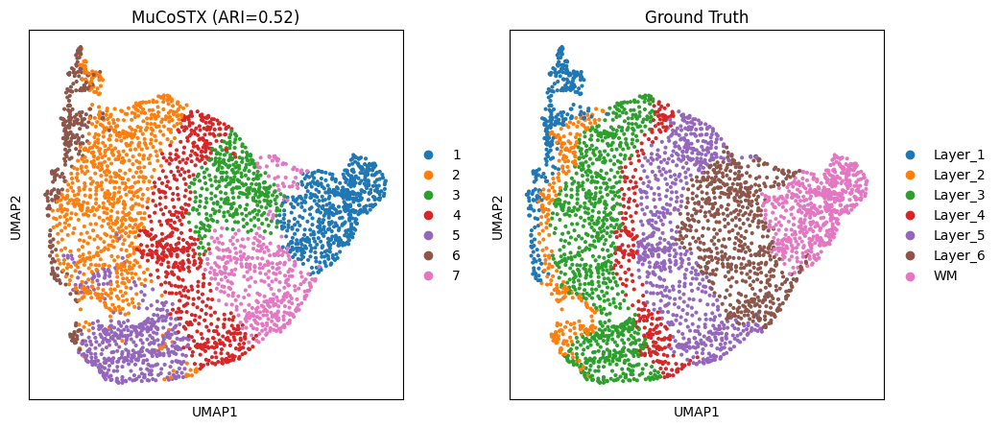

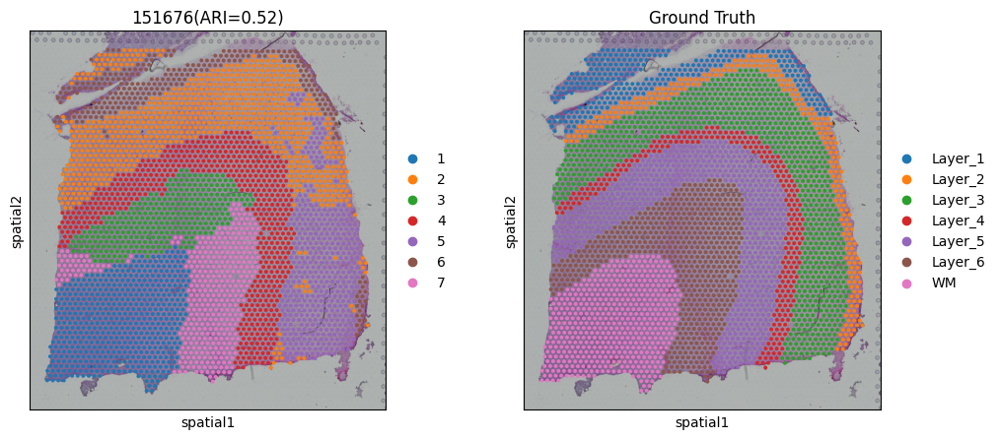

In [ ]:
ari = []
from sklearn.metrics import adjusted_rand_score
from mucostx.utils import mclust
n_d = [7,7,7,7,5,5,5,5,7,7,7,7]
# n_d = [7,7,7,7]
for i in range(12):
    adata_i = list_new[i]
    args.n_domain=n_d[i]
    adata_i = mclust(adata_i, args, refine=False, use='mx')
    adata_i = adata_i[~pd.isnull(adata_i.obs['Ground Truth'])]
    obs_df = adata_i.obs.dropna()
    ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
    ari.append(ARI)
    sc.pp.neighbors(adata_i, use_rep='mx')
    sc.tl.umap(adata_i)
    plt.rcParams["figure.figsize"] = (5, 5)
    sc.pl.umap(adata_i, color=["mclust", "Ground Truth"], title=['MuCoSTX (ARI=%.2f)'%ARI, "Ground Truth"])
    sc.pl.spatial(adata_i,color=["mclust", "Ground Truth"], title=sections[i]+'(ARI=%.2f)'%ARI)

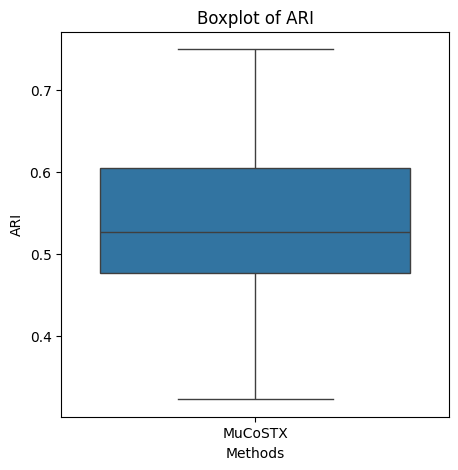

In [ ]:
import seaborn as sns
import pandas as pd

# 示例数据：多个列表
data = {
    "MuCoSTX": ari,
}

# 转换为 DataFrame
df = pd.DataFrame(dict([(k, pd.Series(v)) for k, v in data.items()]))

# 转换为长格式
df_melted = df.melt(var_name="Methods", value_name="ARI")

# 绘制箱线图
sns.boxplot(x="Methods", y="ARI", data=df_melted)

# 添加标题
plt.title("Boxplot of ARI")

# 显示图像
plt.show()
